In [142]:
import numpy as np
import pandas as pd
import os
import torch
import pingouin as pg
from tqdm import tqdm
from nilearn import datasets
from nilearn import plotting
import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
import nibabel as nb
from scipy.stats import pearsonr, spearmanr
from scipy.spatial.distance import correlation
from torch.utils.data import DataLoader, Dataset, Subset
from nilearn.connectome import sym_matrix_to_vec
from sklearn.manifold import TSNE
from ContModeling.helper_classes import MatData
from ContModeling.models import PhenoProj
from hydra import initialize, compose
from omegaconf import DictConfig, OmegaConf
import xarray as xr
from neuromaps.datasets import fetch_fslr, fetch_fsaverage
from brainspace.utils.parcellation import map_to_labels, reduce_by_labels
from brainspace.datasets import load_conte69, load_parcellation
from brainspace.plotting import plot_hemispheres
from surfplot import Plot
import nilearn as nl
import cmasher as cmr
from statsmodels.robust.scale import Huber
from ContModeling.viz_func import replace_with_network


In [143]:
mpl.rcParams['svg.fonttype'] = 'none'

In [144]:
def custom_corr(y, y_pred):
    corr = float(pg.corr(y, y_pred, correction = 'bicor')['r'].values)
    return corr

In [145]:
def get_network_indices(network_labels):
    network_indices = dict.fromkeys(network_labels)
    network_labels = np.array(network_labels)
    for key in network_indices.keys():
        network_indices[key] = np.arange(len(network_labels))[network_labels == key]
    return network_indices

In [148]:
dataset_name = "hcp"
domain = "cog"


In [149]:
if dataset_name == "hcp":
    surfaces = fetch_fslr()
    lh, rh = surfaces['midthickness']
    n_vrtx_hemi = 32492
elif dataset_name == "abcd":
    surfaces = fetch_fsaverage()
    lh, rh = surfaces['white']
    n_vrtx_hemi = 40962

In [150]:
dataset_path = f"data/{dataset_name}_400parcels.nc"
dataset = xr.open_dataset(dataset_path)

In [151]:
mode = "shuffle"
with initialize(version_base=None, config_path="."):
    cfg = compose(config_name=f'{mode}_main_model_config.yaml')
    print(OmegaConf.to_yaml(cfg))

project: ABCD_SHUFFLE_REDMAT_DEC_MULTIVAR_COG
experiment_name: shuffle_redmat_dec_abcd_multivar_cog
hypothesis: '-'
input_dim_feat: 400
output_dim_feat: 100
hidden_dim: 128
input_dim_target: 10
output_dim_target: 64
random_seed:
- 1001
- 42
- 54
- 90
- 101
- 80
- 422
- 142
- 128
- 340
skip_conn: false
skip_enc1: false
ReEig: false
full_model_pretrained: true
mat_ae_pretrained: false
reduced_mat_ae_pretrained: false
mat_ae_pretrained_exp: shuffle_pretrain_mat_ae_abcd
pretrained_reduced_mat_ae_exp: ext_sup_reduced_mat_ae_abcd
full_model_pretrained_exp: shuffle_redmat_enc_abcd_multivar_cog
mat_ae_enc_freeze: true
mat_ae_dec_freeze: true
reduced_mat_ae_enc_freeze: true
reduced_mat_ae_dec_freeze: false
target_dec_freeze: true
best_mat_ae_fold: 2
best_reduced_mat_ae_fold: 4
synth_exp: false
multi_gpu: true
num_epochs: 500
batch_size: 256
n_runs: 1
lr: 0.001
weight_decay: 0.0001
dropout_rate: 0
scheduler_patience: 20
test_ratio: 0.3
train_ratio:
- 1.0
log_gradients: true
clip_grad: true
netwo

In [152]:
data_path = cfg.dataset.dataset_path
results_path = './results'

In [153]:
# fig_dir = os.path.join(results_path, f"{mode}_redmat_dec_abcd_multivar_{domain}_only", 'figures')
fig_dir = f"./figures/{dataset_name}_{mode}_{domain}"
os.makedirs(fig_dir, exist_ok=True)

### Matrix Reconstruction

In [154]:
mode = "shuffle"

train_ratio = 1.0
exp_name = f"{mode}_redmat_dec_{dataset_name}_multivar_{domain}"
exp_dir = f'./results/{exp_name}'
recon_dir = f'{exp_dir}/recon_mat'

In [155]:
exp_name

'shuffle_redmat_dec_hcp_multivar_cog'

In [156]:
if mode == 'shuffle':
    n_runs = cfg.random_seed
    run_type = "seed"
    test_type = "test"
else:
    n_runs = np.arange(cfg.kfolds)
    run_type = "fold"
    test_type = "validation"

In [157]:
recon_dir

'./results/shuffle_redmat_dec_hcp_multivar_cog/recon_mat'

In [158]:
predictions = pd.read_csv(f'{exp_dir}/pred_results.csv')

In [159]:
test_idx = np.concatenate([np.load(f'{exp_dir}/{test_type}_idx_{run_type}{run}_train_ratio{train_ratio}.npy') for run in n_runs])
recon_mat = np.concatenate([np.load(f'{recon_dir}/recon_mat_{run_type}{run}_train_ratio{train_ratio}.npy') for run in n_runs], axis = 0)
mape_mat = np.concatenate([np.load(f'{recon_dir}/mape_mat_{run_type}{run}_train_ratio{train_ratio}.npy') for run in n_runs], axis = 0)
true_mat = np.stack([dataset.matrices.isel(index = idx).values for idx in test_idx])

In [160]:
subj_atlas = np.array([np.concatenate([dataset.isel(index=idx).parc_lh.values, dataset.isel(index=idx).parc_rh.values]) for idx in test_idx])

In [161]:
def compute_batch_elementwise_correlation(true, recon):
    batch_size, rows, cols = true.shape
    correlations = np.zeros((rows, cols))

    flat_true = true.reshape(batch_size, -1)
    flat_recon = recon.reshape(batch_size, -1)
    
    for i in range(rows * cols):
        correlations[i // cols, i % cols] = spearmanr(flat_true[:, i], flat_recon[:, i])[0]
        
    np.fill_diagonal(correlations, 1.0)

    return correlations

In [162]:
def sort_corrs_by_network(mat_corr, network_labels):
    discard_ones_mat = mat_corr.copy()
    np.fill_diagonal(discard_ones_mat, 0)

    corr_data = {
        'Correlation': [],
        'Network': []
    }

    for i, network in enumerate(np.unique(network_labels)):
        network_indices = [i for i, label in enumerate(network_labels) if label == network]
        print(f"Network {network}: {network_indices} nodes")
        subset_network = discard_ones_mat[network_indices].T[network_indices].flatten()
        print(discard_ones_mat[network_indices].T[network_indices].shape)
        corr_data['Correlation'].extend(subset_network)
        corr_data['Network'].extend(len(subset_network) * [network])
        
    corr_data = pd.DataFrame(corr_data)
    corr_data = corr_data[corr_data['Correlation'] != 0]

    return corr_data

In [163]:
# def sort_corrs_by_network(mat_corr, network_labels):
#     corr_data = {
#         'Correlation': [],
#         'Network': []
#     }
#     for i, network in enumerate(network_labels):
#         corr_data['Correlation'].extend([mat_corr[i, i]])
#         corr_data['Network'].extend([network])
        
#     corr_data = pd.DataFrame(corr_data)

#     return corr_data

In [164]:
atlas_7labels = datasets.fetch_atlas_schaefer_2018()['labels']
atlas_17labels = pd.read_csv(f'./data/parcellations/Schaefer2018_400Parcels_Kong2022_17Networks_order_info.txt', dtype=str, header=None).to_numpy().T[0][::2]

atlas_7labels = [label.decode('utf-8') for label in atlas_7labels]

network7_labels = ['Vis',
                'SomMot',
                'DorsAttn',
                'SalVentAttn',
                'Limbic',
                'Cont',
                'Default'
]

network17_labels = [
                    'DefaultA',
                    'DefaultB',
                    'DefaultC',
                    'Language',
                    'ContA',
                    'ContB',
                    'ContC',
                    'SalVenAttnA',
                    'SalVenAttnB',
                    'DorsAttnA',
                    'DorsAttnB',
                    'Aud',
                    'SomMotA',
                    'SomMotB',
                    'VisualA',
                    'VisualB',
                    'VisualC',
]

network7_labels = [replace_with_network(label, network7_labels) for label in atlas_7labels]
network17_labels = [replace_with_network(label, network17_labels) for label in atlas_17labels]

network7_indices = get_network_indices(network7_labels)
network17_indices = get_network_indices(network17_labels)

yeo7_colors ={
    'Vis': '#761984',
    'SomMot':'#4679a4',
    'DorsAttn':'#0a7316',
    'SalVentAttn':'#ba3eec',
    'Limbic':'#92ab67',
    'Cont':'#d78e27',
    'Default':'#c4414f'
}

yeo_17colors = dict.fromkeys(network7_labels)

yeo17_colors ={
    'DefaultA': '#ffff00',
    'DefaultB': '#cd3e4e',
    'DefaultC': '#000082',
    'Language': '#0c30ff',
    'ContA': '#e69422',
    'ContB': '#87324a',
    'ContC': '#778cb0',
    'SalVenAttnA': '#c43afa',
    'SalVenAttnB': '#ff98d5',
    'DorsAttnA': '#4a9b3c',
    'DorsAttnB': '#00760e',
    'Aud': '#dcf8a4',
    'SomMotA': '#4682b4',
    'SomMotB': '#2acca4',
    'VisualA': '#781286',
    'VisualB': '#ff0000',
    'VisualC': '#7a8732',
}

network7_colors = [yeo7_colors[network] for network in network7_labels]
network17_colors = [yeo17_colors[network] for network in network17_labels]


In [165]:
recon_corr_mat = compute_batch_elementwise_correlation(true_mat, recon_mat)

/Users/VictoriaShevchenko/opt/miniconda3/envs/neuro/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4916: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


In [167]:
np.save(f'{fig_dir}/recon_corr_mat_{dataset_name}_{domain}.npy', recon_corr_mat)

In [96]:
recon_corr_mat = np.load(f'{fig_dir}/recon_corr_mat_{dataset_name}_{domain}.npy')

In [168]:
recon_corr_by_7networks = sort_corrs_by_network(recon_corr_mat, network7_labels)
recon_corr_by_17networks = sort_corrs_by_network(recon_corr_mat, network17_labels)

Network Cont: [126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 331, 332, 333, 334, 335, 336, 337, 338, 339, 340, 341, 342, 343, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353, 354, 355, 356, 357, 358, 359, 360] nodes
(52, 52)
Network Default: [148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 361, 362, 363, 364, 365, 366, 367, 368, 369, 370, 371, 372, 373, 374, 375, 376, 377, 378, 379, 380, 381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 391, 392, 393, 394, 395, 396, 397, 398, 399] nodes
(91, 91)
Network DorsAttn: [68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 2

In [ ]:
# sns.set_style("whitegrid")
# # reorder the DataFrame by the order of the network labels
# recon_corr_by_7networks['Network'] = pd.Categorical(recon_corr_by_7networks['Network'],
#                                                     categories=["Vis",
#                                                                 "SomMot",
#                                                                 "DorsAttn",
#                                                                 "SalVentAttn",
#                                                                 "Limbic",
#                                                                 "Cont",
#                                                                 "Default"],
#                                                                 ordered=True)
# sns.boxplot(data=recon_corr_by_7networks, x='Network', y='Correlation', hue='Network',
#                legend=True,
#                palette=yeo7_colors.values())
# plt.xticks([], [])
# plt.legend(title='Network', bbox_to_anchor=(1.05, 1), loc='upper left')
# # plt.ylim(-.05, 1.05)
# # plt.legend(title='Agg Measure: All wrt Centroid', bbox_to_anchor=(1.05, 1), loc='upper left')
# # plt.xlabel('Value')
# # plt.xlabel('Agg Measure: All wrt Centroid')
# # plt.title(r"Aggregate measures across clusters")
# plt.title("Correlations by network, 7 Yeo Networks")
# plt.savefig(f'{fig_dir}/recon_corr_by_7networks_{dataset_name}_{domain}.svg', format = "svg", dpi = 300, bbox_inches='tight')

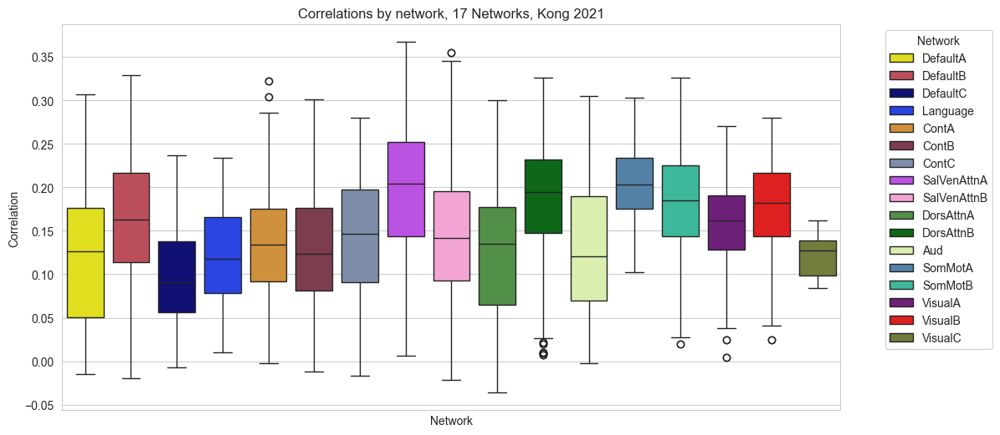

In [170]:
sns.set_style("whitegrid")
plt.figure(figsize=(12, 6))
# reorder the DataFrame by the order of the network labels
recon_corr_by_17networks['Network'] = pd.Categorical(recon_corr_by_17networks['Network'],
                                                    categories=[
                                                        'DefaultA',
                                                        'DefaultB',
                                                        'DefaultC',
                                                        'Language',
                                                        'ContA',
                                                        'ContB',
                                                        'ContC',
                                                        'SalVenAttnA',
                                                        'SalVenAttnB',
                                                        'DorsAttnA',
                                                        'DorsAttnB',
                                                        'Aud',
                                                        'SomMotA',
                                                        'SomMotB',
                                                        'VisualA',
                                                        'VisualB',
                                                        'VisualC',
                                                        ],
                                                        ordered=True)
sns.boxplot(data=recon_corr_by_17networks, x='Network', y='Correlation', hue='Network',
               legend=True,
               palette=yeo17_colors.values())
plt.xticks([], [])
plt.legend(title='Network', bbox_to_anchor=(1.05, 1), loc='upper left')
# plt.ylim(-.05, 1.05)
# plt.legend(title='Agg Measure: All wrt Centroid', bbox_to_anchor=(1.05, 1), loc='upper left')
# plt.xlabel('Value')
# plt.xlabel('Agg Measure: All wrt Centroid')
plt.title("Correlations by network, 17 Networks, Kong 2021")
plt.savefig(f'{fig_dir}/recon_corr_by_17networks_{dataset_name}_{domain}.svg', format = "svg", dpi = 300, bbox_inches='tight')

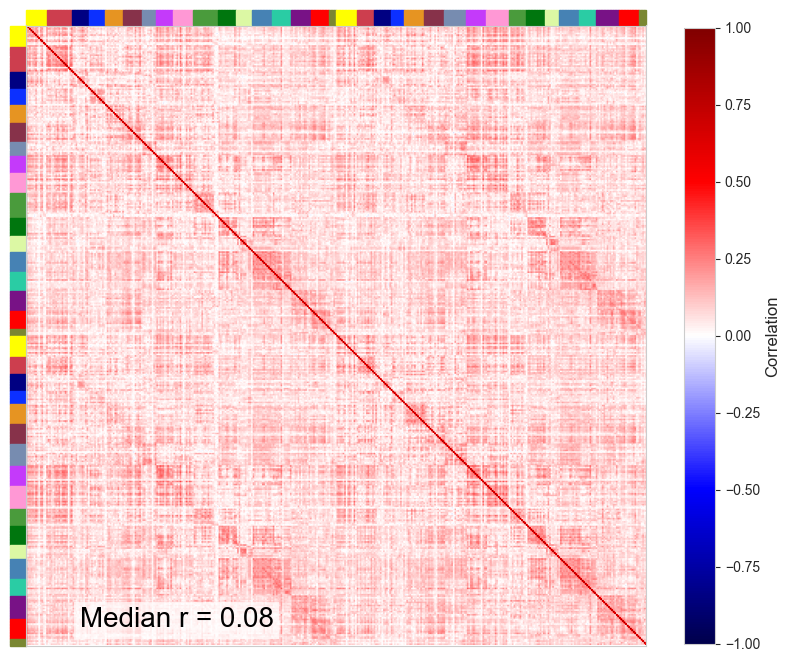

In [172]:
from matplotlib.patches import Rectangle

f, ax = plt.subplots(figsize = (10, 10))
im = ax.imshow(recon_corr_mat, cmap='seismic', vmin=-1, vmax=1)
# axes[1].set_title(f'Cluster {cluster}: Matrix closest to the centroid')
cbar = f.colorbar(im, ax=ax, shrink=0.8)  # Adjust `shrink` to control the size of the colorbar
cbar.set_label("Correlation", fontsize=12)
plt.text(0.4, 0.02, f'Median r = {np.median(recon_corr_mat):.2f}', color='black', ha='right', va='bottom', fontsize=20, transform=plt.gca().transAxes,
        bbox=dict(facecolor='white', alpha=0.7, edgecolor='none'))

ax.set_xticks([])
ax.set_yticks([])
for i, color in enumerate(network17_colors):
    ax.add_patch(Rectangle((-0.5, i - 0.5)
    , -10, 1, color=color, clip_on=False))
    ax.add_patch(Rectangle((i - 0.5, -0.7), 1, -10, color=color, clip_on=False))

plt.savefig(f"{fig_dir}/corr_true_recon_{dataset_name}_{domain}.svg", format = "svg", dpi = 300, bbox_inches='tight')


In [101]:
huber_estimator = Huber(maxiter = 1000)

In [ ]:
robust_mean_mape_mat = np.empty((400, 400))
for i in range(400):
    for j in range(400):
        robust_mean_mape_mat[i, j], _ = huber_estimator(mape_mat[:, i, j], initscale=np.array(1000))

np.save(f'{fig_dir}/robust_mean_mape_mat_{dataset_name}_{domain}.npy', robust_mean_mape_mat)

In [173]:
robust_mean_mape_mat = np.load(f'{fig_dir}/robust_mean_mape_mat_{dataset_name}_{domain}.npy')

In [104]:
f'{fig_dir}/robust_mean_mape_mat_{dataset_name}_{domain}.npy'

'./figures/abcd_shuffle_psy/robust_mean_mape_mat_abcd_psy.npy'

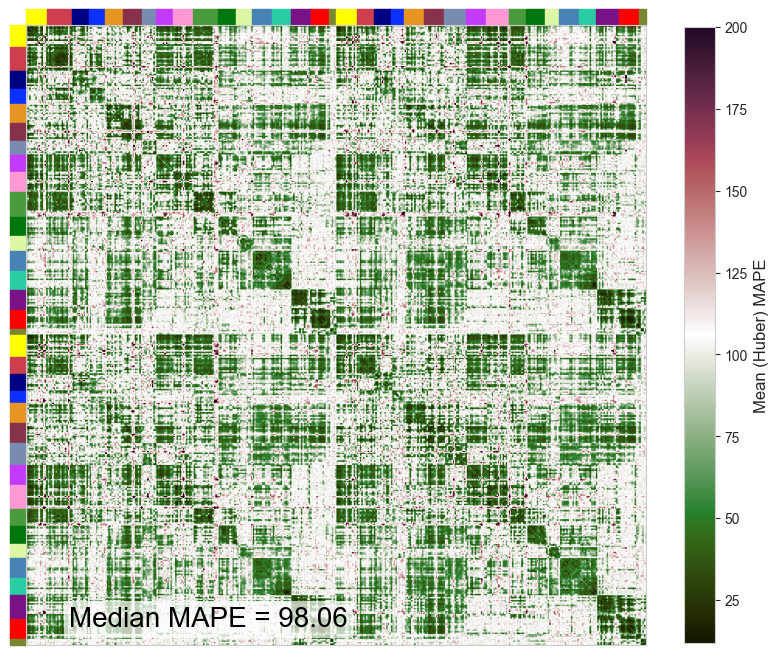

In [174]:
from matplotlib.patches import Rectangle

f, ax = plt.subplots(figsize = (10, 10))
im = ax.imshow(robust_mean_mape_mat, cmap='cmr.holly', vmax=200)
# axes[1].set_title(f'Cluster {cluster}: Matrix closest to the centroid')
cbar = f.colorbar(im, ax=ax, shrink=0.8)  # Adjust `shrink` to control the size of the colorbar
cbar.set_label("Mean (Huber) MAPE", fontsize=12)
plt.text(0.52, 0.02, f'Median MAPE = {np.median(robust_mean_mape_mat):.2f}', color='black', ha='right', va='bottom', fontsize=20, transform=plt.gca().transAxes,
        bbox=dict(facecolor='white', alpha=0.7, edgecolor='none'))

ax.set_xticks([])
ax.set_yticks([])
for i, color in enumerate(network17_colors):
    ax.add_patch(Rectangle((-0.5, i - 0.5), -10, 1, color=color, clip_on=False))
    ax.add_patch(Rectangle((i - 0.5, -0.7), 1, -10, color=color, clip_on=False))

plt.savefig(f"{fig_dir}/robust_mean_mape_mat_{dataset_name}_{domain}.svg", format = "svg", dpi = 300, bbox_inches='tight')

In [181]:
mape_by_7networks = sort_corrs_by_network(robust_mean_mape_mat, network7_labels)
mape_by_17networks = sort_corrs_by_network(robust_mean_mape_mat, network17_labels)

Network Cont: [126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 331, 332, 333, 334, 335, 336, 337, 338, 339, 340, 341, 342, 343, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353, 354, 355, 356, 357, 358, 359, 360] nodes
(52, 52)
Network Default: [148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 361, 362, 363, 364, 365, 366, 367, 368, 369, 370, 371, 372, 373, 374, 375, 376, 377, 378, 379, 380, 381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 391, 392, 393, 394, 395, 396, 397, 398, 399] nodes
(91, 91)
Network DorsAttn: [68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 2

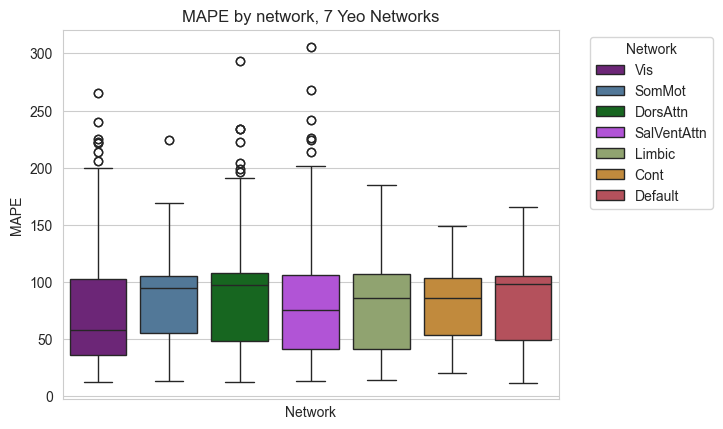

In [182]:
sns.set_style("whitegrid")
# reorder the DataFrame by the order of the network labels
mape_by_7networks['Network'] = pd.Categorical(mape_by_7networks['Network'],
                                            categories=["Vis",
                                                        "SomMot",
                                                        "DorsAttn",
                                                        "SalVentAttn",
                                                        "Limbic",
                                                        "Cont",
                                                        "Default"],
                                                        ordered=True)
sns.boxplot(data=mape_by_7networks, x='Network', y='Correlation', hue='Network',
               legend=True,
               palette=yeo7_colors.values())
plt.xticks([], [])
plt.ylabel('MAPE')
plt.legend(title='Network', bbox_to_anchor=(1.05, 1), loc='upper left')
# plt.ylim(-.05, 1.05)
# plt.legend(title='Agg Measure: All wrt Centroid', bbox_to_anchor=(1.05, 1), loc='upper left')
# plt.xlabel('Value')
# plt.xlabel('Agg Measure: All wrt Centroid')
# plt.title(r"Aggregate measures across clusters")
plt.title("MAPE by network, 7 Yeo Networks")
plt.savefig(f'{fig_dir}/mape_by_7networks_{dataset_name}_{domain}.svg', format = "svg", dpi = 300, bbox_inches='tight')

In [183]:
mape_by_17networks.groupby('Network').aggregate(['mean', 'std', 'min', 'max']).reset_index()

Network Correlation                                  
                       mean        std        min         max
0           Aud   68.508321  27.389996  24.796504  130.672678
1         ContA   57.287164  31.069539  12.976265  143.080339
2         ContB   62.014061  39.779389  13.289187  223.834495
3         ContC   69.940704  38.459939  12.102158  233.524882
4      DefaultA   64.705966  46.921062  12.734615  239.619585
5      DefaultB   50.528930  30.569090  16.484096  175.734850
6      DefaultC   64.630379  35.463968  15.506827  247.720325
7     DorsAttnA   61.123403  37.701686  14.613885  184.701968
8     DorsAttnB   48.682337  22.514652  20.852997  133.674224
9      Language   68.999876  28.103935  23.897514  165.133100
10  SalVenAttnA   50.281508  27.580224  20.956846  190.557121
11  SalVenAttnB   67.138213  46.215390  13.559810  305.887863
12      SomMotA   44.801398  10.632394  17.273036   94.695485
13      SomMotB   43.307889  16.393801  12.740667  128.487628
14      VisualA   48.742062  29.044129  14.273130  152.776801
15      VisualB   36.690647  19.127038  11.868044  131.178994
16      VisualC   53.362897  32.800107  13.561249  121.227345

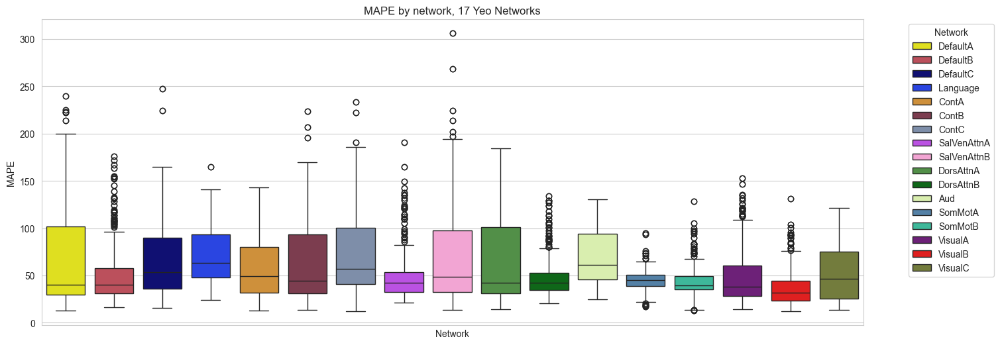

In [184]:
mape_by_17networks['Network'] = pd.Categorical(mape_by_17networks['Network'],
                                                    categories=[
                                                        'DefaultA',
                                                        'DefaultB',
                                                        'DefaultC',
                                                        'Language',
                                                        'ContA',
                                                        'ContB',
                                                        'ContC',
                                                        'SalVenAttnA',
                                                        'SalVenAttnB',
                                                        'DorsAttnA',
                                                        'DorsAttnB',
                                                        'Aud',
                                                        'SomMotA',
                                                        'SomMotB',
                                                        'VisualA',
                                                        'VisualB',
                                                        'VisualC',
                                                        ],
                                                        ordered=True)
sns.set_style("whitegrid")
plt.figure(figsize=(16, 6))
sns.boxplot(data=mape_by_17networks, x='Network', y='Correlation', hue='Network',
               legend=True,
               palette=yeo17_colors.values())
plt.xticks([], [])
plt.ylabel('MAPE')
plt.legend(title='Network', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.title("MAPE by network, 17 Yeo Networks")
plt.savefig(f'{fig_dir}/mape_by_17networks_{dataset_name}_{domain}.svg', format = "svg", dpi = 300, bbox_inches='tight')

In [120]:
mape_labeled = []
recon_mat_labeled = []
true_mat_labeled = []
for true, recon, mape, parc_labels in tqdm(zip(true_mat, recon_mat, mape_mat, subj_atlas)):
    true_copy, recon_copy, mape_copy = true.copy(), recon.copy(), mape.copy()

    np.fill_diagonal(true_copy, 0)
    np.fill_diagonal(recon_copy, 0)
    np.fill_diagonal(mape, 0)

    robust_mean_mape_mean_across_regions = np.empty((400))
    for i in range(400):
        robust_mean_mape_mean_across_regions[i], _ = huber_estimator(mape[i], initscale=np.array(1000))

    mean_recon_across_regions = np.mean(recon_copy, axis = 0)
    mean_true_across_regions = np.mean(true_copy, axis = 0)

    mean_mape_regions_mapped = map_to_labels(robust_mean_mape_mean_across_regions, parc_labels, mask=parc_labels != 0, fill=np.nan)
    mean_recon_across_regions_mapped = map_to_labels(mean_recon_across_regions, parc_labels, mask=parc_labels != 0, fill=np.nan)
    mean_true_across_regions_mapped = map_to_labels(mean_true_across_regions, parc_labels, mask=parc_labels != 0, fill=np.nan)
    
    mape_labeled.append(mean_mape_regions_mapped)
    recon_mat_labeled.append(mean_recon_across_regions_mapped)
    true_mat_labeled.append(mean_true_across_regions_mapped)

mape_labeled = np.array(mape_labeled)
recon_mat_labeled = np.array(recon_mat_labeled)
true_mat_labeled = np.array(true_mat_labeled)


3087it [12:20,  4.17it/s]


In [121]:
np.save(f'{fig_dir}/mape_labeled_{dataset_name}_{domain}.npy', mape_labeled)
np.save(f'{fig_dir}/recon_mat_labeled_{dataset_name}_{domain}.npy', recon_mat_labeled)
np.save(f'{fig_dir}/true_mat_labeled_{dataset_name}_{domain}.npy', true_mat_labeled)

In [180]:
mean_mape_regions_mapped = np.load(f'{fig_dir}/mean_mape_regions_mapped_{dataset_name}_{domain}.npy')

FileNotFoundError: [Errno 2] No such file or directory: './figures/abcd_shuffle_psy/mean_mape_regions_mapped_hcp_psy.npy'

In [65]:
# sns.histplot(sym_matrix_to_vec(mape_mat, discard_diagonal=True).flatten(), bins=100, log_scale = True)
# median = np.median(sym_matrix_to_vec(mape_mat, discard_diagonal=True).flatten())
# plt.axvline(median, color='r', linestyle='--', linewidth=2, label=f'Median: {median:.2f}')
# plt.xlim(10**-2, 10**5)
# plt.legend()
# plt.savefig(f"./abstract_viz/mat_mape_dist{filename_suffix}.svg", format = "svg", dpi = 300, bbox_inches='tight')

### Plotting on Surfaces

In [ ]:
mape_labeled = np.load(f'{fig_dir}/mape_labeled_{dataset_name}_{domain}.npy')
recon_mat_labeled = np.load(f'{fig_dir}/recon_mat_labeled_{dataset_name}_{domain}.npy')
true_mat_labeled = np.load(f'{fig_dir}/true_mat_labeled_{dataset_name}_{domain}.npy')

In [122]:
recon_corr_surf = []
for i in tqdm(range(len(recon_mat_labeled.T))):
    if np.isnan(recon_mat_labeled.T[i]).any() or np.isnan(true_mat_labeled.T[i]).any():
        recon_corr_surf.append(np.nan)
    else:
        recon_corr_surf.append(custom_corr(recon_mat_labeled.T[i], true_mat_labeled.T[i]))
        
recon_corr_surf = np.array(recon_corr_surf)


  0%|          | 0/64984 [00:00<?, ?it/s]/var/folders/2m/72fcyjmd7vs3g18rkfwx7nw40000gn/T/ipykernel_82844/2168649317.py:2: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  corr = float(pg.corr(y, y_pred, correction = 'bicor')['r'].values)
/var/folders/2m/72fcyjmd7vs3g18rkfwx7nw40000gn/T/ipykernel_82844/2168649317.py:2: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  corr = float(pg.corr(y, y_pred, correction = 'bicor')['r'].values)
/var/folders/2m/72fcyjmd7vs3g18rkfwx7nw40000gn/T/ipykernel_82844/2168649317.py:2: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a si

In [ ]:
np.save(f'{fig_dir}/recon_corr_surf_{dataset_name}_{domain}.npy', recon_corr_surf)

In [70]:
atlas_labels = nl.datasets.fetch_atlas_schaefer_2018(yeo_networks=17)['labels']
atlas_labels = [label.decode('utf-8') for label in atlas_labels]
NETWORK_LABELS = ['VisCent', 'VisPeri',  'SomMotA', 'SomMotB', 'DorsAttnA', 'DorsAttnB',
                  'SalVentAttnA', 'SalVentAttnB', 'LimbicA', 'LimbicB', 'ContA', 'ContA',
                  'DefaultA', 'DefaultB','TempPar']
NETWORK_LABELS = [replace_with_network(label, NETWORK_LABELS) for label in atlas_labels]

In [125]:
# replace with unique numbers from 1 to 7 in the list

mapping = list(set(NETWORK_LABELS))
mapping = {mapping[i]: float(i) for i in range(len(mapping))}

NETWORK_LABELS_NUMBERED = np.array([mapping[label] for label in NETWORK_LABELS])

In [186]:
robust_mean_mape_mat = np.load(f'{fig_dir}/robust_mean_mape_mat_{dataset_name}_{domain}.npy')

In [208]:
dataset_name = "abcd"
domain = "cog"
fig_dir = f"./figures/{dataset_name}_{mode}_{domain}"
np.load(f'{fig_dir}/robust_mean_mape_mat_{dataset_name}_{domain}.npy')

array([[ 66.54988472,  43.08727528,  70.00354219, ..., 101.2759701 ,
        100.73588473, 102.57725355],
       [ 43.08727566,  66.0228945 ,  50.32289767, ..., 116.55294942,
         99.6964696 , 103.39350723],
       [ 70.00354044,  50.32289672,  60.13963638, ..., 102.29090035,
        104.94695846, 110.36094361],
       ...,
       [101.27596464, 116.55294915, 102.2909022 , ...,  64.55473145,
        124.0886607 ,  79.03210147],
       [100.73588519,  99.69646723, 104.94695828, ..., 124.08866194,
         57.50565251,  93.38271487],
       [102.57725388, 103.39350936, 110.36092793, ...,  79.03210039,
         93.38271552,  53.31186534]])

In [209]:
dataset_name = "abcd"
domain = "psy"
fig_dir = f"./figures/{dataset_name}_{mode}_{domain}"
np.load(f'{fig_dir}/robust_mean_mape_mat_{dataset_name}_{domain}.npy')

array([[ 67.01937287,  42.14707743,  67.24658874, ..., 102.78642647,
        100.84119981, 103.24820009],
       [ 42.14707724,  66.24983919,  49.64152791, ..., 117.71255911,
         98.75431873, 103.51651149],
       [ 67.24658874,  49.64152696,  60.70562955, ..., 104.88564816,
        106.44860017, 108.85575397],
       ...,
       [102.78642789, 117.71256143, 104.88565194, ...,  64.9242287 ,
        122.89285625,  77.74798921],
       [100.84120117,  98.75431993, 106.44860134, ..., 122.89285721,
         58.01635503,  90.77598396],
       [103.24819873, 103.51651114, 108.85575762, ...,  77.74798949,
         90.77598359,  54.00184996]])

In [187]:
robust_mean_mape_mat = np.load(f'{fig_dir}/robust_mean_mape_mat_{dataset_name}_{domain}.npy')

In [58]:
mape_group_mapped = []

for order_idx, idx in enumerate(test_idx):
    atlas_labels = subj_atlas[idx]
    group_mape_mapped_subj = map_to_labels(np.mean(robust_mean_mape_mat, axis = 0), atlas_labels, mask=atlas_labels != 0, fill=np.nan)
    mape_group_mapped.append(group_mape_mapped_subj)
mape_group_mapped = np.array(mape_group_mapped)

KeyboardInterrupt: 

In [191]:
schaefer17_labels = nb.load("./data/parcellations/Schaefer2018_400Parcels_Kong2022_17Networks_order.dscalar.nii").get_fdata()[0]

In [63]:
group_mape_mapped = map_to_labels(np.mean(robust_mean_mape_mat, axis = 0), schaefer17_labels, mask=schaefer17_labels != 0, fill=np.nan)

In [188]:
schaefer17_labels.shape

(64984,)

In [72]:
f"{fig_dir}/mape_labeled_{dataset_name}_{domain}.svg"

'./figures/hcp_shuffle_cog/mape_labeled_hcp_cog.svg'

In [ ]:
if dataset_name == "hcp":
    surfaces = fetch_fslr()
    lh, rh = surfaces['midthickness']
    n_vrtx_hemi = 32492
elif dataset_name == "abcd":
    surfaces = fetch_fsaverage()
    lh, rh = surfaces['white']
    n_vrtx_hemi = 40962

Text(0.5, 1.0, 'Mean MAPE Across Edges')

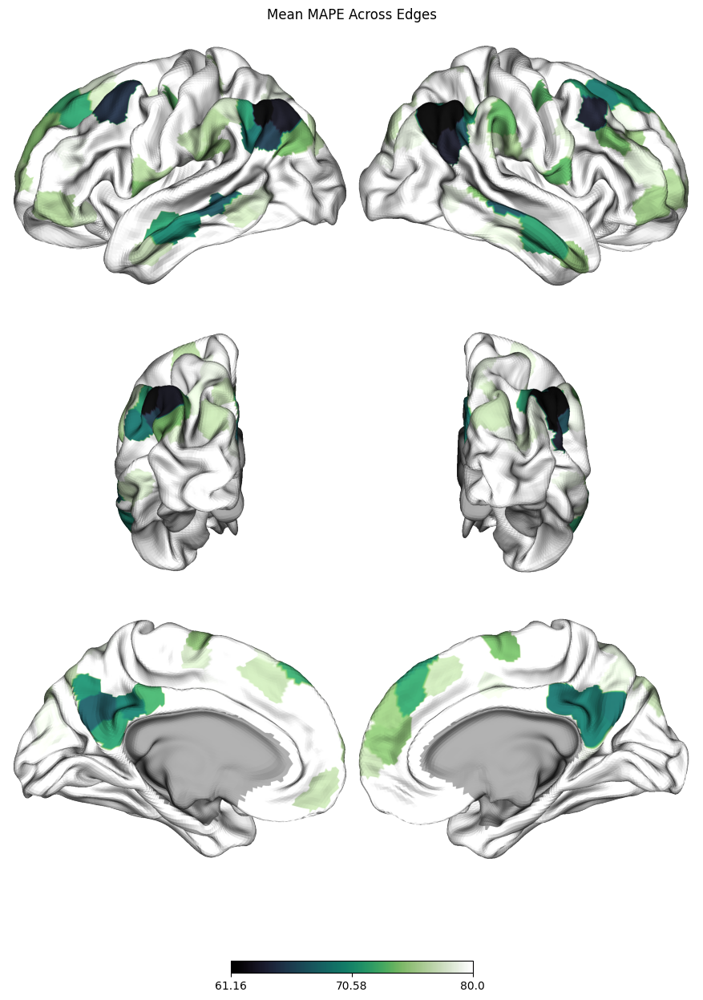

In [64]:
cmap = plt.get_cmap('cmr.swamp')
mape_plot = Plot(lh, rh, size=(1200, 1500), brightness=0.5, views=['lateral', 'posterior', 'medial'])
mape_plot.add_layer({'left': group_mape_mapped[:n_vrtx_hemi],
                     'right': group_mape_mapped[n_vrtx_hemi:]},
                     cbar=True, cmap=cmap, 
                     color_range=(61.16, 80),
                     zero_transparent=True,
                     alpha=1
)

fig = mape_plot.build()
fig.axes[0].set_title('Mean MAPE Across Edges', pad=-3)
# fig.savefig(f"{fig_dir}/mape_labeled_{dataset_name}_{domain}.svg", format = "svg", dpi = 300, bbox_inches='tight')

In [53]:
recon_corr_mat = np.load(f'{fig_dir}/recon_corr_mat_{dataset_name}_{domain}.npy')


In [23]:
group_corr_mapped = []
recon_corr_mat_copy = recon_corr_mat.copy()
np.fill_diagonal(recon_corr_mat_copy, 0)

for order_idx, idx in enumerate(test_idx):
    atlas_labels = subj_atlas[idx]
    group_corr_mapped_subj = map_to_labels(np.mean(recon_corr_mat_copy, axis = 0), atlas_labels, mask=atlas_labels != 0, fill=np.nan)
    group_corr_mapped.append(group_corr_mapped_subj)
group_corr_mapped = np.array(group_corr_mapped)

In [ ]:
group_corr_mapped_mean = np.mean(group_corr_mapped, axis = 0)
top_10percent = np.nanpercentile(group_corr_mapped_mean, 80)


In [46]:
schaefer17_labels = nb.load("/Users/VictoriaShevchenko/Documents/contrastive-learning/data/parcellations/Schaefer2018_400Parcels_Kong2022_17Networks_order.dscalar.nii").get_fdata()[0]

In [48]:
sub = 30

In [3]:
from scipy.io import loadmat
hcp_parc=loadmat("/Users/VictoriaShevchenko/Documents/contrastive-learning/HCP_1029sub_400Parcels_Kong2022_gMSHBM.mat")

In [54]:
corr_mapped = map_to_labels(recon_corr_mat.mean(axis=0), subj_atlas[sub], mask=subj_atlas[sub] != 0, fill=np.nan)

In [56]:
corr_mapped = map_to_labels(recon_corr_mat.mean(axis=0), schaefer17_labels, mask=schaefer17_labels != 0, fill=np.nan)


In [39]:
group_prior_kong = loadmat("/Users/VictoriaShevchenko/Downloads/group.mat")

In [61]:
import nibabel as nib
nib.load(lh)

TypeError: 'PosixPath' object is not subscriptable

Text(0.5, 1.0, 'Mean Corr Across Edges: True Conn vs. Recon')

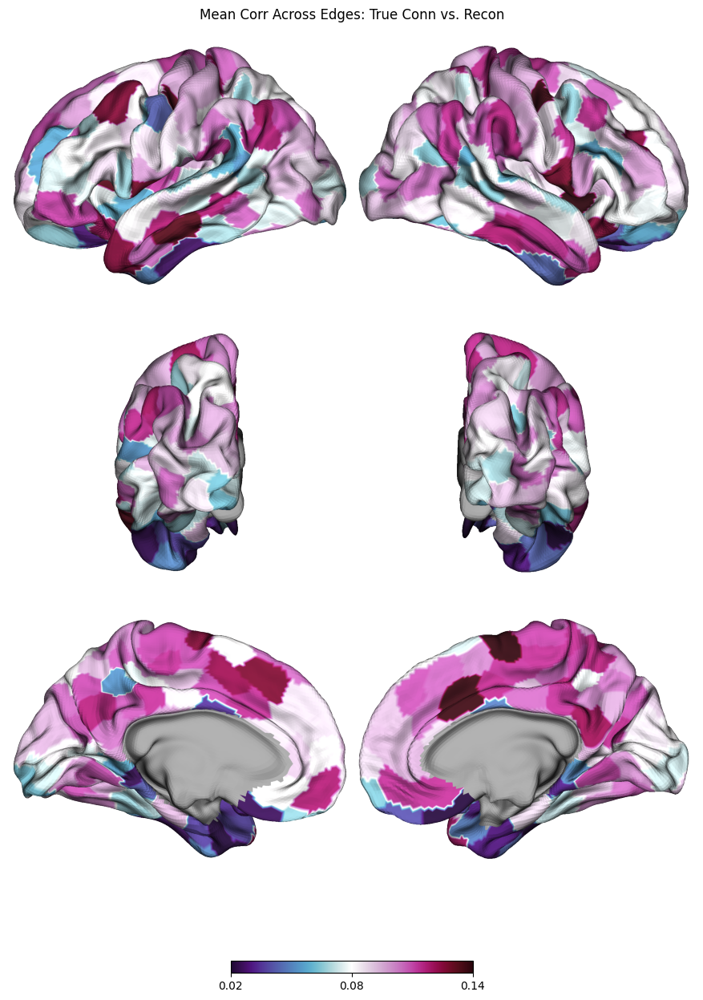

In [57]:
cmap = plt.get_cmap('cmr.viola')

plot = Plot(lh, rh, size=(1200, 1500), brightness=0.5, views=['lateral', 'posterior', 'medial'])
plot.add_layer({'left': corr_mapped[:n_vrtx_hemi],
                'right': corr_mapped[n_vrtx_hemi:]},
                     cbar=True, cmap=cmap,
                    #  color_range=(top_10percent, 0.17),
                     zero_transparent=False,
                     
                     alpha=1,

)
# mape_plot.add_layer({'left': NETWORK_LABELS_NUMBERED_SURF[:32492],
#                      'right': NETWORK_LABELS_NUMBERED_SURF[32492:]}, cmap='gray',
#             as_outline=True, cbar=False)
fig = plot.build()
fig.axes[0].set_title('Mean Corr Across Edges: True Conn vs. Recon', pad=-3)
# fig.savefig(f"{fig_dir}/recon_corr_labeled_{dataset_name}_{domain}.svg", format = "svg", dpi = 300, bbox_inches='tight')

In [48]:
np.load("/Users/VictoriaShevchenko/Documents/contrastive-learning/data/HCP_1029sub_400parcels_Kong2022_gMSHB_FC_all.npy")

array([[[ 1.        ,  0.5946063 ,  0.4015074 , ...,  0.18243706,
          0.26279616,  0.01346764],
        [ 0.5946063 ,  1.        ,  0.4549557 , ...,  0.16270594,
          0.29368114, -0.0255703 ],
        [ 0.4015074 ,  0.4549557 ,  1.        , ..., -0.0257437 ,
          0.16814412, -0.08719708],
        ...,
        [ 0.18243706,  0.16270594, -0.0257437 , ...,  1.        ,
          0.5293573 ,  0.7401111 ],
        [ 0.26279616,  0.29368114,  0.16814412, ...,  0.5293573 ,
          1.        ,  0.318228  ],
        [ 0.01346764, -0.0255703 , -0.08719708, ...,  0.7401111 ,
          0.318228  ,  1.        ]],

       [[ 1.        ,  0.69081455,  0.6274541 , ..., -0.15731084,
         -0.01186504, -0.16972102],
        [ 0.69081455,  1.        ,  0.7801826 , ..., -0.18526657,
         -0.02713386, -0.28289354],
        [ 0.6274541 ,  0.7801826 ,  1.        , ..., -0.1730445 ,
          0.01378876, -0.21850488],
        ...,
        [-0.15731084, -0.18526657, -0.1730445 , ...,  

Text(0.5, 1.0, 'Mean Corr Across Edges: True Conn vs. Recon')

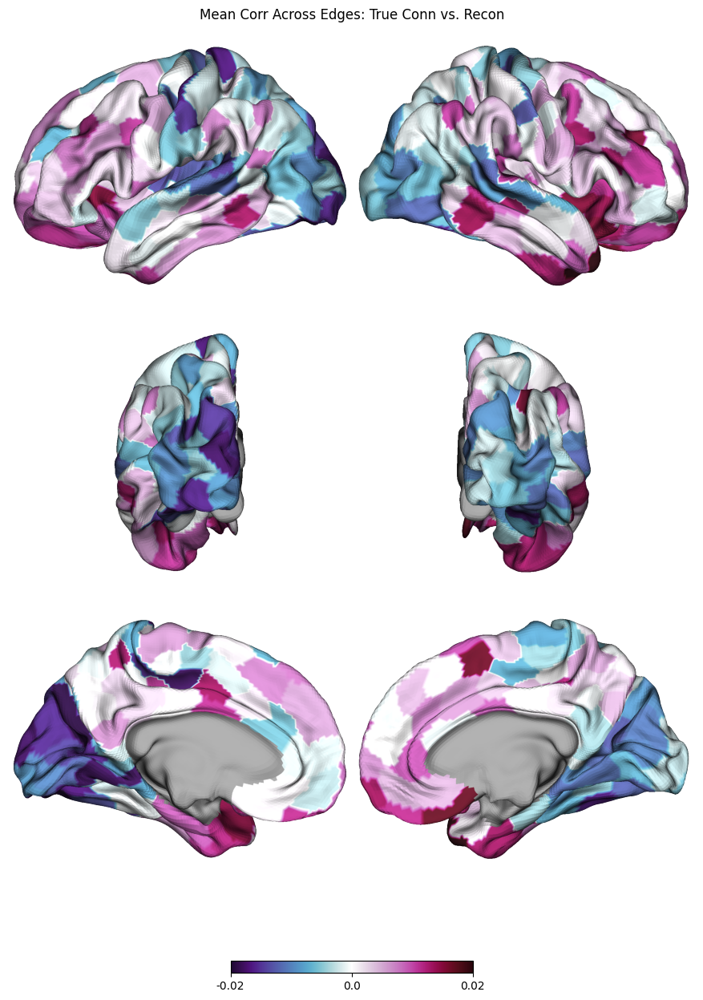

In [42]:
cmap = plt.get_cmap('cmr.viola')

plot = Plot(lh, rh, size=(1200, 1500), brightness=0.5, views=['lateral', 'posterior', 'medial'])
plot.add_layer({'left': corr_mapped[:n_vrtx_hemi],
                'right': corr_mapped[n_vrtx_hemi:]},
                     cbar=True, cmap=cmap,
                    #  color_range=(top_10percent, 0.17),
                     zero_transparent=False,
                     
                     alpha=1,

)
# mape_plot.add_layer({'left': NETWORK_LABELS_NUMBERED_SURF[:32492],
#                      'right': NETWORK_LABELS_NUMBERED_SURF[32492:]}, cmap='gray',
#             as_outline=True, cbar=False)
fig = plot.build()
fig.axes[0].set_title('Mean Corr Across Edges: True Conn vs. Recon', pad=-3)

In [ ]:
cmap = plt.get_cmap('cmr.flamingo_r')

plot = Plot(lh, rh, size=(1200, 1500), brightness=0.5, views=['lateral', 'posterior', 'medial'])
plot.add_layer({'left': np.mean(group_corr_mapped, axis = 0)[:n_vrtx_hemi],
                'right': np.mean(group_corr_mapped, axis = 0)[n_vrtx_hemi:]},
                     cbar=True, cmap=cmap,
                     color_range=(0.02, np.nanmax(np.mean(group_corr_mapped, axis = 0))),
                     zero_transparent=False,
                     alpha=1,

)
# mape_plot.add_layer({'left': NETWORK_LABELS_NUMBERED_SURF[:32492],
#                      'right': NETWORK_LABELS_NUMBERED_SURF[32492:]}, cmap='gray',
#             as_outline=True, cbar=False)
fig = plot.build()
fig.axes[0].set_title('Mean Corr Across Edges: True Conn vs. Recon', pad=-3)
fig.savefig(f"{fig_dir}/recon_corr_labeled_{dataset_name}_{domain}.svg", format = "svg", dpi = 300, bbox_inches='tight')

In [77]:
np.nanmax(group_corr_mapped, axis = 0)

/var/folders/2m/72fcyjmd7vs3g18rkfwx7nw40000gn/T/ipykernel_31547/2672695814.py:1: RuntimeWarning: All-NaN slice encountered
  np.nanmax(group_corr_mapped, axis = 0)


array([0.00788317, 0.02072704, 0.01077473, ..., 0.00373716, 0.00373716,
       0.00373716])

In [90]:
count = 0
for i, mat_idx in enumerate(overlap_test_idx[:10]):
        idx = np.where(test_idx == mat_idx)[0][0]
        recon = recon_mat[idx]
        mape = mape_mat[idx]
        true = dataset.matrices.isel(subject = mat_idx).values

        residual = true - recon

        fig, axes = plt.subplots(1, 4, figsize=(36, 7))

        plotting.plot_matrix(true,
        axes = axes[0],
        vmax = 1.,
        vmin = -1.,
        )

        plotting.plot_matrix(recon,
        axes = axes[1],
        vmax = 1.,
        vmin = -1.,        
        )

        plotting.plot_matrix(residual,
        axes = axes[2],
        vmax = 1.,
        vmin = -1.,   
        )

        plotting.plot_matrix(mape,
        axes = axes[3],
        vmax = 100, vmin=0
        )
        plt.savefig(f"./abstract_viz/individual_recon_idx{mat_idx}{filename_suffix}.svg", format = "svg", dpi = 300, bbox_inches='tight')


NameError: name 'overlap_test_idx' is not defined

In [56]:
true_mat_vec = sym_matrix_to_vec(true_mat, discard_diagonal = True)
recon_mat_vec = sym_matrix_to_vec(recon_mat, discard_diagonal = True)

In [60]:
sim_null_dist = []
for i in tqdm(range(10)):
    shuffled_recon = recon_mat_vec.copy()
    np.random.shuffle(shuffled_recon)
    sim = np.diag(cosine_similarity(recon_mat_vec, shuffled_recon)).mean()
    sim_null_dist.append(sim)
sim_null_dist = np.array(sim_null_dist)

100%|█████████████████████████████████████████████████████████████████████| 10/10 [05:53<00:00, 35.32s/it]


In [61]:
sim_null_dist

array([0.6893528 , 0.69074255, 0.6894885 , 0.68904436, 0.69011223,
       0.6886922 , 0.6904257 , 0.6904854 , 0.68943465, 0.69275093],
      dtype=float32)

In [ ]:
np.concatenate(sim_null_dist, np.diag(cosine_similarity(recon_mat_vec, true_mat_vec)).mea)

In [62]:
np.diag(cosine_similarity(recon_mat_vec, true_mat_vec)).mean()

np.float64(0.8782642169059856)